# __Importing required libraries__

In [2]:
import os
import imageio
import numpy as np
from PIL import Image
import cv2
from skimage import io
from tqdm.auto import tqdm
from xml.etree import ElementTree
from matplotlib import pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms.functional as TF
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from torchsummary import summary

# __Augmentation for face__

In [3]:
class FaceAugmentation:
    def __init__(self,
                 image_dim,
                 brightness,    
                 contrast,
                 saturation,
                 hue,
                 face_offset,
                 crop_offset):
        
        self.image_dim = image_dim
        self.face_offset = face_offset
        self.crop_offset = crop_offset
        self.transform = transforms.ColorJitter(brightness, contrast, saturation, hue)
    
    def offset_crop(self, image, landmarks, crops_coordinates):
        left = int(crops_coordinates['left']) - self.face_offset
        top = int(crops_coordinates['top']) - self.face_offset
        width = int(crops_coordinates['width']) + (2 * self.face_offset)
        height = int(crops_coordinates['height']) + (2 * self.face_offset)

        image = TF.crop(image, top, left, height, width)
        landmarks = landmarks - np.array([[left, top]])

        new_dim = self.image_dim + self.crop_offset

        image = TF.resize(image, (new_dim, new_dim))

        landmarks[:, 0] *= new_dim / width
        landmarks[:, 1] *= new_dim / height

        return image, landmarks
    
    def random_face_crop(self, image, landmarks):
        image = np.array(image)

        h, w = image.shape[:2]

        top = np.random.randint(0, h - self.image_dim)
        left = np.random.randint(0, w - self.image_dim)

        image = image[top: top + self.image_dim, left: left + self.image_dim]

        landmarks = landmarks - np.array([[left, top]])

        return TF.to_pil_image(image), landmarks
    
    def __call__(self, image, landmarks, crops_coordinates):
        image, landmarks = self.offset_crop(image, landmarks, crops_coordinates)

        image, landmarks = self.random_face_crop(image, landmarks)

        return self.transform(image), landmarks

# __Augmentation for landmarks__

In [4]:
class LandmarksAugmentation:
    def __init__(self, rotation_limit):
        self.rotation_limit = rotation_limit

    def random_rotation(self, image, landmarks):
        angle = np.random.uniform(-self.rotation_limit, self.rotation_limit)
        landmarks_transformation = np.array([
            [+np.cos(np.radians(angle)), -np.sin(np.radians(angle))], 
            [+np.sin(np.radians(angle)), +np.cos(np.radians(angle))]
        ])
        image = TF.rotate(image, angle)
        landmarks = landmarks - 0.5
        transformed_landmarks = np.matmul(landmarks, landmarks_transformation)
        transformed_landmarks = transformed_landmarks + 0.5

        return image, transformed_landmarks
    
    def __call__(self, image, landmarks):
        image, landmarks = self.random_rotation(image, landmarks)
        return image, landmarks

# __Data Preprocessing__

In [5]:
class Preprocessor:
    def __init__(self,
                 image_dim,
                 brightness,
                 contrast,
                 saturation,
                 hue,
                 angle,
                 face_offset,
                 crop_offset):
        
        self.image_dim = image_dim

        self.landmarks_augmentation = LandmarksAugmentation(image_dim, angle)
        self.face_augmentation = FaceAugmentation(image_dim, brightness, contrast, saturation, hue, face_offset, crop_offset)
    
    def __call__(self, image, landmarks, crops_coordinates):
        image = TF.to_pil_image(image)

        image, landmarks = self.face_augmentation(image, landmarks, crops_coordinates)

        landmarks = landmarks / np.array([*image.size])

        image, landmarks = self.landmarks_augmentation(image, landmarks)

        image = TF.to_grayscale(image)

        image = TF.to_tensor(image)

        image = (image - image.min())/(image.max() - image.min())
        image = (2 * image) - 1

        return image, torch.FloatTensor(landmarks.reshape(-1) - 0.5)

# __Creating the dataset class__

In [6]:
class LandmarksDataset(Dataset):
    def __init__(self, preprocessor, train):
        self.root_dir = 'ibug_300W_large_face_landmark_dataset'
        
        self.image_paths = []
        self.landmarks = []
        self.crops = []
        self.preprocessor = preprocessor
        self.train = train
        
        tree = ElementTree.parse(os.path.join(self.root_dir, f'labels_ibug_300W_{"train" if train else "test"}.xml'))
        root = tree.getroot()
        
        for filename in root[2]:
            self.image_paths.append(os.path.join(self.root_dir, filename.attrib['file']))

            self.crops.append(filename[0].attrib)

            landmark = []
            for num in range(68):
                x_coordinate = int(filename[0][num].attrib['x'])
                y_coordinate = int(filename[0][num].attrib['y'])
                landmark.append([x_coordinate, y_coordinate])
            self.landmarks.append(landmark)

        self.landmarks = np.array(self.landmarks).astype('float32')

        assert len(self.image_paths) == len(self.landmarks)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, index):
        image = io.imread(self.image_paths[index], as_gray = False)
        landmarks = self.landmarks[index]
        
        image, landmarks = self.preprocessor(image, landmarks, self.crops[index])

        return image, landmarks

# __Some helper functions for visualizing the data__

In [8]:
def visualize_image(image, landmarks):
    plt.figure(figsize = (5, 5))
    image = (image - image.min())/(image.max() - image.min())

    landmarks = landmarks.view(-1, 2)
    landmarks = (landmarks + 0.5) * preprocessor.image_dim

    plt.imshow(image[0], cmap = 'gray')
    plt.scatter(landmarks[:, 0], landmarks[:, 1], s = 25, c = 'dodgerblue')
    plt.axis('off')
    plt.show()
    
def visualize_batch(images_list, landmarks_list, size = 14, shape = (6, 6), title = None, save = None):
    fig = plt.figure(figsize = (size, size))
    grid = ImageGrid(fig, 111, nrows_ncols = shape, axes_pad = 0.08)
    for ax, image, landmarks in zip(grid, images_list, landmarks_list):
        image = (image - image.min())/(image.max() - image.min())

        landmarks = landmarks.view(-1, 2)
        landmarks = (landmarks + 0.5) * preprocessor.image_dim
        landmarks = landmarks.numpy().tolist()
        landmarks = np.array([(x, y) for (x, y) in landmarks if 0 <= x <= preprocessor.image_dim and 0 <= y <= preprocessor.image_dim])

        ax.imshow(image[0], cmap = 'gray')
        ax.scatter(landmarks[:, 0], landmarks[:, 1], s = 10, c = 'dodgerblue')
        ax.axis('off')

    if title:
        print(title)
    if save:
        plt.savefig(save)
    plt.show()

# __Initializing preprocessor, train and test images__

In [7]:
preprocessor = Preprocessor(
    image_dim = 128,
    brightness = 0.24,
    saturation = 0.3,
    contrast = 0.15,
    hue = 0.14,
    angle = 14,
    face_offset = 32,
    crop_offset = 16)

train_images = LandmarksDataset(preprocessor, train = True)
test_images = LandmarksDataset(preprocessor, train = False)

# __Visualizing a sample image, with random augmentations__

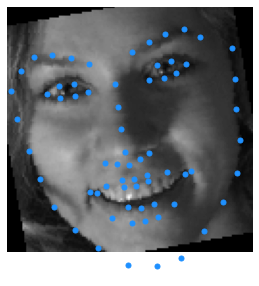

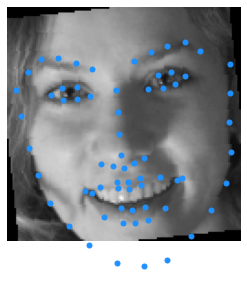

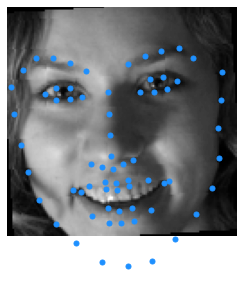

In [9]:
image1, landmarks1 = train_images[64]
visualize_image(image1, landmarks1)

image2, landmarks2 = train_images[64]
visualize_image(image2, landmarks2)

image3, landmarks3 = train_images[64]
visualize_image(image3, landmarks3)

In [10]:
len_val_set = int(0.1 * len(train_images))
len_train_set = len(train_images) - len_val_set

print(f'{len_train_set} images for training')
print(f'{len_val_set} images for validating')
print(f'{len(test_images)} images for testing')

train_images, val_images = random_split(train_images, [len_train_set, len_val_set])

batch_size = 32
train_data = torch.utils.data.DataLoader(train_images, batch_size = batch_size, shuffle = True)
val_data = torch.utils.data.DataLoader(val_images, batch_size = 2 * batch_size, shuffle = False)
test_data = torch.utils.data.DataLoader(test_images, batch_size = 2 * batch_size, shuffle = False)

6000 images for training
666 images for validating
1008 images for testing


# __Visualizing a sample batch__

In [11]:
for x, y in train_data:
    break

print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

for x, y in val_data:
    break

print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

for x, y in test_data:
    break

print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

torch.Size([32, 1, 128, 128]) torch.Size([32, 136]) tensor(1.) tensor(-1.) tensor(0.6575) tensor(-0.6730)
torch.Size([64, 1, 128, 128]) torch.Size([64, 136]) tensor(1.) tensor(-1.) tensor(0.9143) tensor(-0.7215)
torch.Size([64, 1, 128, 128]) torch.Size([64, 136]) tensor(1.) tensor(-1.) tensor(0.8512) tensor(-0.7057)


Training Batch Samples


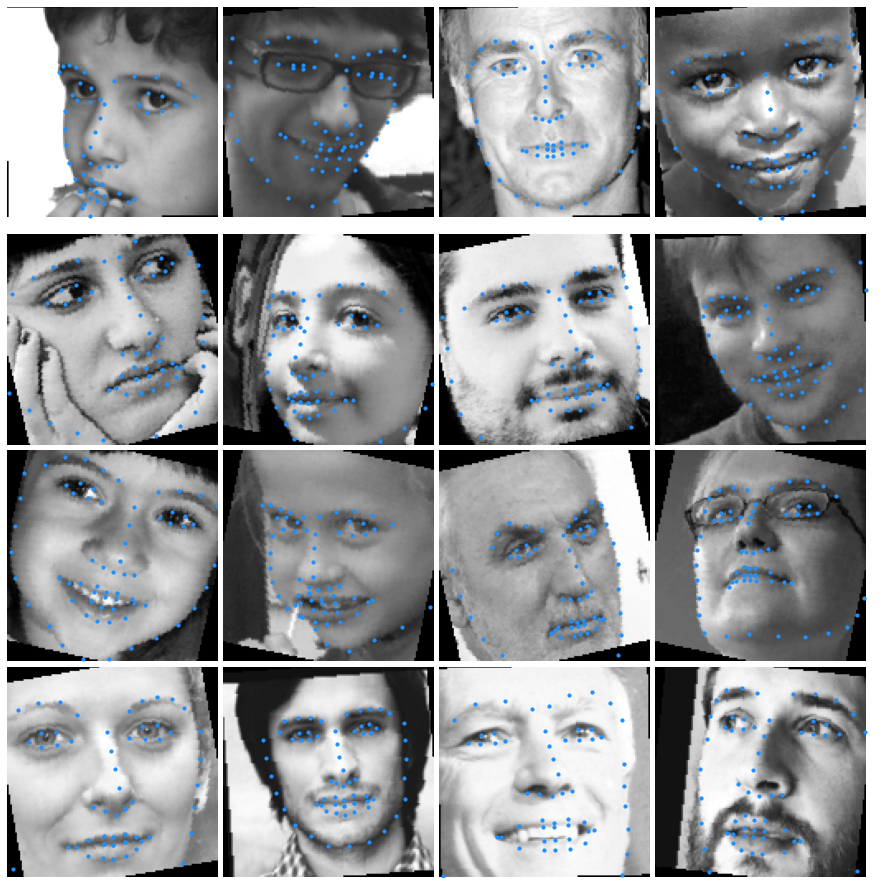

In [ ]:
visualize_batch(x[:16], y[:16], shape = (4, 4), size = 16, title = 'Training Batch Samples')

# __Creating Xception Net model architecture__

In [12]:
class DepthewiseSeperableConv2d(nn.Module):
    def __init__(self, input_channels, output_channels, kernel_size, **kwargs):
        super(DepthewiseSeperableConv2d, self).__init__()

        self.depthwise = nn.Conv2d(input_channels, input_channels, kernel_size, groups = input_channels, bias = False, **kwargs)
        self.pointwise = nn.Conv2d(input_channels, output_channels, 1, bias = False)

    def forward(self, x):
        x = self.depthwise(x)
        x = self.pointwise(x)

        return x

In [13]:
class EntryBlock(nn.Module):
    def __init__(self):
        super(EntryBlock, self).__init__()

        self.conv1 = nn.Sequential(
            nn.Conv2d(1, 32, 3, padding = 1, bias = False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2)
        )

        self.conv2 = nn.Sequential(
            nn.Conv2d(32, 64, 3, padding = 1, bias = False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2)
        )

        self.conv3_residual = nn.Sequential(
            DepthewiseSeperableConv2d(64, 64, 3, padding = 1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(64, 128, 3, padding = 1),
            nn.BatchNorm2d(128),
            nn.MaxPool2d(3, stride = 2, padding = 1),
        )

        self.conv3_direct = nn.Sequential(
            nn.Conv2d(64, 128, 1, stride = 2),
            nn.BatchNorm2d(128),
        )

        self.conv4_residual = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(128, 128, 3, padding = 1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(128, 256, 3, padding = 1),
            nn.BatchNorm2d(256),
            nn.MaxPool2d(3, stride = 2, padding = 1)
        )

        self.conv4_direct = nn.Sequential(
            nn.Conv2d(128, 256, 1, stride = 2),
            nn.BatchNorm2d(256),
        )

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)

        residual = self.conv3_residual(x)
        direct = self.conv3_direct(x)
        x = residual + direct
        
        residual = self.conv4_residual(x)
        direct = self.conv4_direct(x)
        x = residual + direct

        return x

In [14]:
class MiddleBasicBlock(nn.Module):
    def __init__(self):
        super(MiddleBasicBlock, self).__init__()

        self.conv1 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )
        self.conv2 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )
        self.conv3 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )

    def forward(self, x):
        residual = self.conv1(x)
        residual = self.conv2(residual)
        residual = self.conv3(residual)

        return x + residual


class MiddleBlock(nn.Module):
    def __init__(self, num_blocks):
        super().__init__()

        self.block = nn.Sequential(*[MiddleBasicBlock() for _ in range(num_blocks)])

    def forward(self, x):
        x = self.block(x)

        return x

In [15]:
class ExitBlock(nn.Module):
    def __init__(self):
        super(ExitBlock, self).__init__()

        self.residual = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 512, 3, padding = 1),
            nn.BatchNorm2d(512),
            nn.MaxPool2d(3, stride = 2, padding = 1)
        )

        self.direct = nn.Sequential(
            nn.Conv2d(256, 512, 1, stride = 2),
            nn.BatchNorm2d(512)
        )

        self.conv = nn.Sequential(
            DepthewiseSeperableConv2d(512, 512, 3, padding = 1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(512, 1024, 3, padding = 1),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2)
        )

        self.dropout = nn.Dropout(0.3)

        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))

    def forward(self, x):
        direct = self.direct(x)
        residual = self.residual(x)
        x = direct + residual
        
        x = self.conv(x)
        x = self.avgpool(x)
        x = self.dropout(x)

        return x

# __Initializing the Xception Net model__

In [16]:
class XceptionNet(nn.Module):
    def __init__(self, num_middle_blocks = 6):
        super(XceptionNet, self).__init__()

        self.entry_block = EntryBlock()
        self.middel_block = MiddleBlock(num_middle_blocks)
        self.exit_block = ExitBlock()

        self.fc = nn.Linear(1024, 136)

    def forward(self, x):
        x = self.entry_block(x)
        x = self.middel_block(x)
        x = self.exit_block(x)

        x = x.view(x.size(0), -1)
        
        x = self.fc(x)

        return x

In [18]:
model = XceptionNet()
model.cuda()

XceptionNet(
  (entry_block): EntryBlock(
    (conv1): Sequential(
      (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (conv2): Sequential(
      (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (conv3_residual): Sequential(
      (0): DepthewiseSeperableConv2d(
        (depthwise): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64, bias=False)
        (pointwise): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      )
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
      (3): DepthewiseSeperableConv2d(
        (dep

In [19]:
summary(model, (1, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 128, 128]             288
       BatchNorm2d-2         [-1, 32, 128, 128]              64
         LeakyReLU-3         [-1, 32, 128, 128]               0
            Conv2d-4         [-1, 64, 128, 128]          18,432
       BatchNorm2d-5         [-1, 64, 128, 128]             128
         LeakyReLU-6         [-1, 64, 128, 128]               0
            Conv2d-7         [-1, 64, 128, 128]             576
            Conv2d-8         [-1, 64, 128, 128]           4,096
DepthewiseSeperableConv2d-9         [-1, 64, 128, 128]               0
      BatchNorm2d-10         [-1, 64, 128, 128]             128
        LeakyReLU-11         [-1, 64, 128, 128]               0
           Conv2d-12         [-1, 64, 128, 128]             576
           Conv2d-13        [-1, 128, 128, 128]           8,192
DepthewiseSeperableConv2d-14    

# __Initializing the objective loss and optimizer__

In [20]:
objective = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr = 0.0008)

# __Defining validation function__


Validation sample predictions


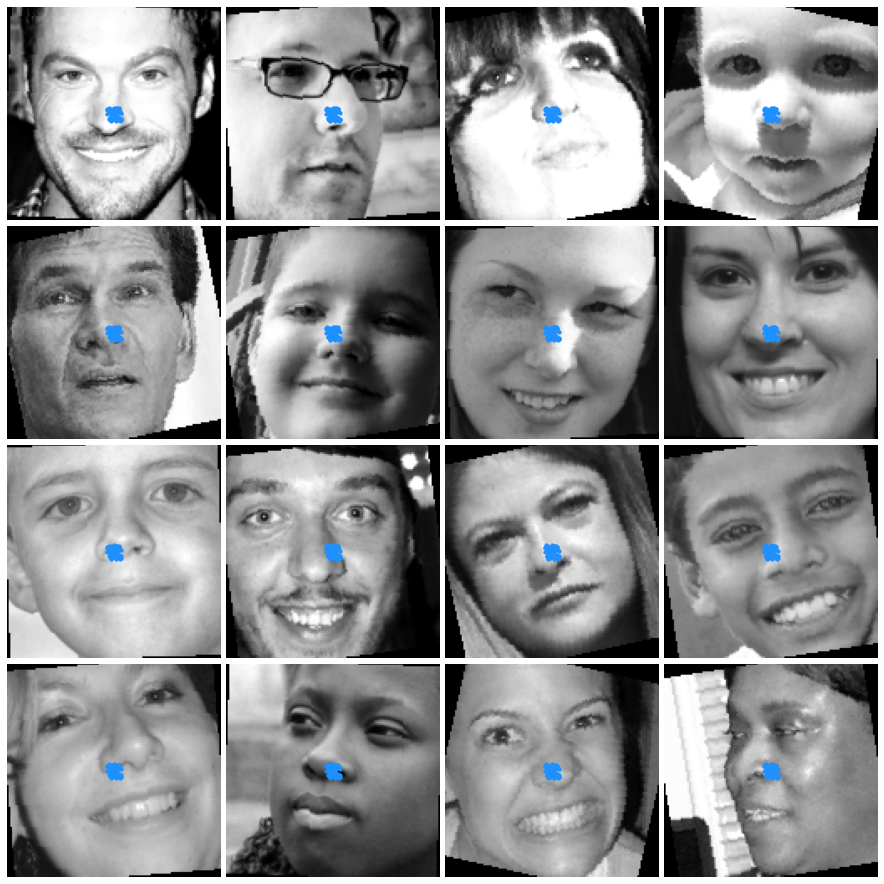

0.005667501552538438

In [21]:
@torch.no_grad()
def validate(save = None):
    cum_loss = 0.0

    model.eval()

    for features, labels in tqdm(val_data, desc = 'Validating', ncols = 600):
        features = features.cuda()
        labels = labels.cuda()

        outputs = model(features)

        loss = objective(outputs, labels)

        cum_loss += loss.item()

        break
        
    visualize_batch(features[:16].cpu(), outputs[:16].cpu(), shape = (4, 4), size = 16, title = 'Validation sample predictions', save = save)

    return cum_loss/len(val_data)

validate()

# Creating directory for storing the model's progress

In [22]:
if os.path.isdir('progress'):
    !rm -rf progress
os.mkdir('progress')

# __And finally training the model__


Validation Sample Predictions


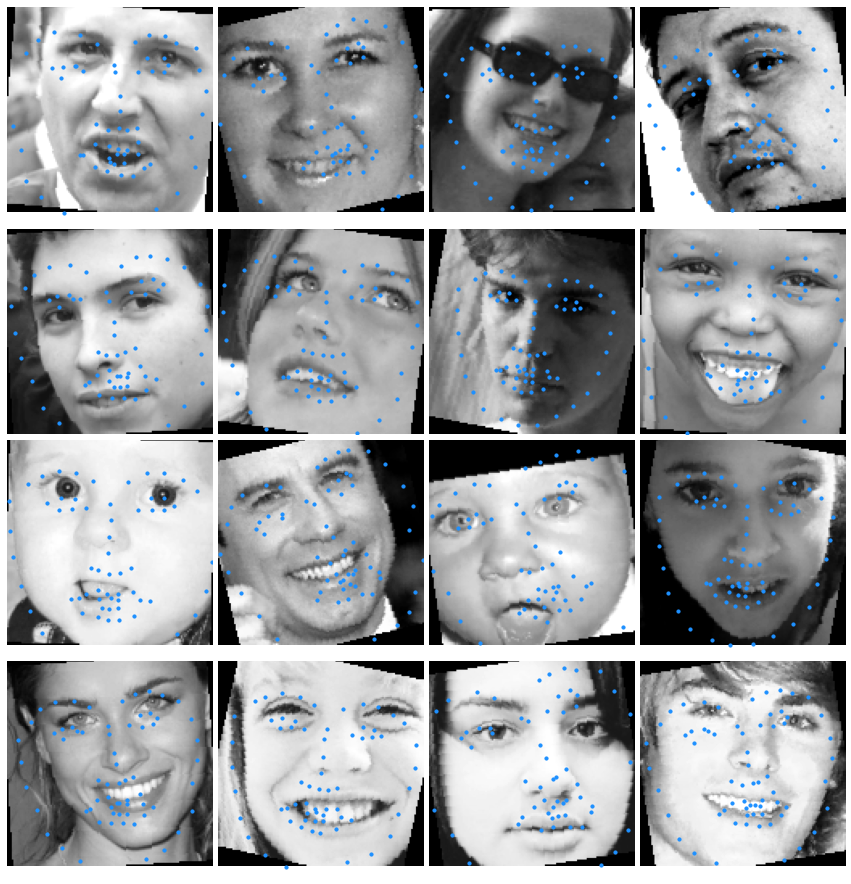

Saving model....................
Epoch(1/30) -> Training Loss: 0.01009990 | Validation Loss: 0.00725029



Validation Sample Predictions


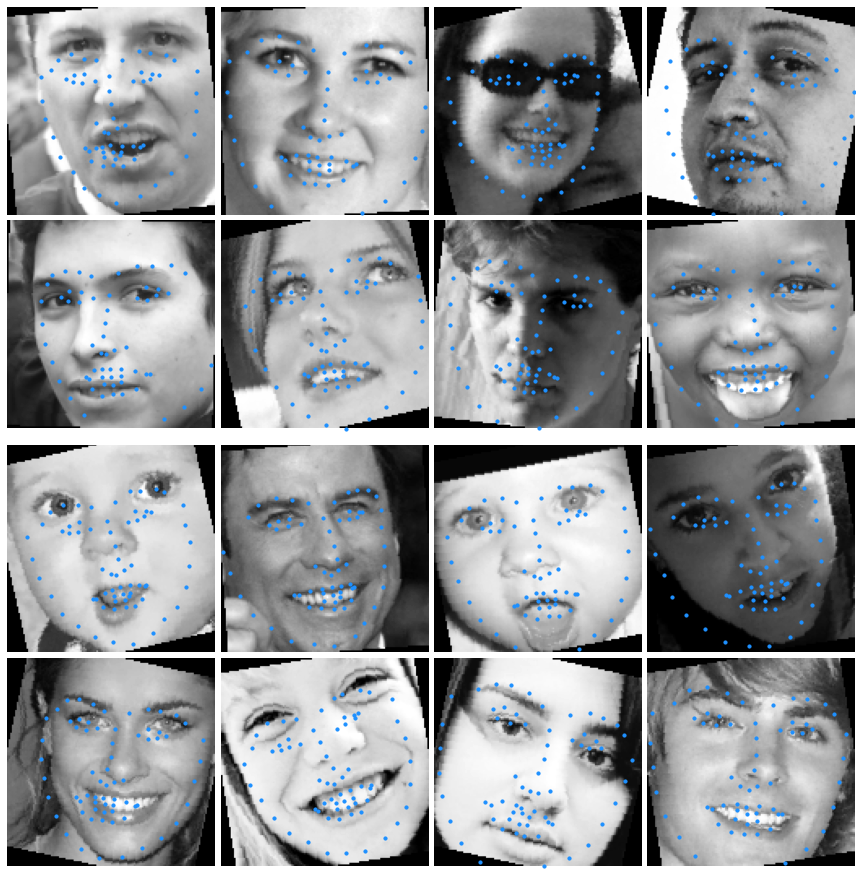

Saving model....................
Epoch(2/30) -> Training Loss: 0.00619011 | Validation Loss: 0.00488666



Validation Sample Predictions


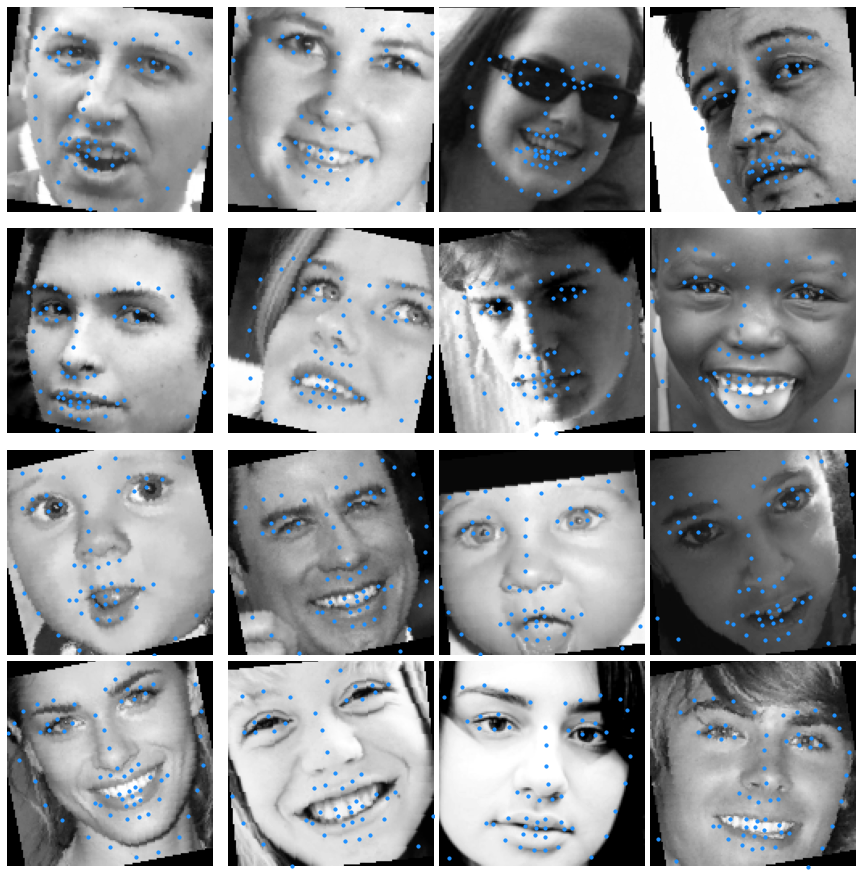

Saving model....................
Epoch(3/30) -> Training Loss: 0.00366693 | Validation Loss: 0.00263462



Validation Sample Predictions


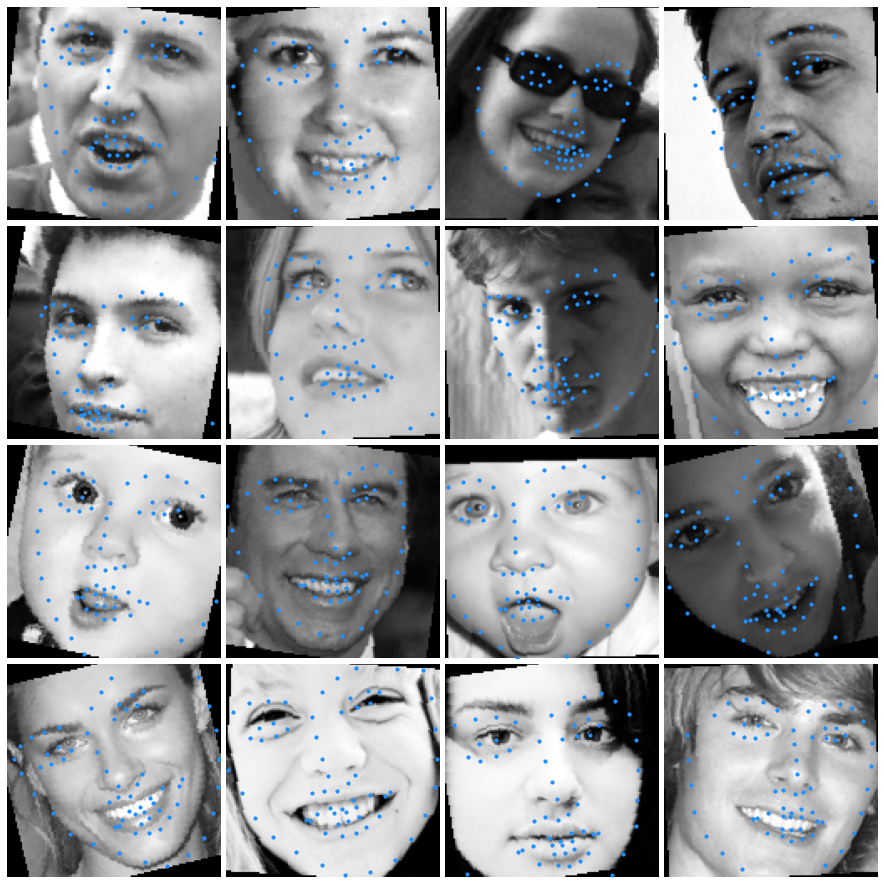

Epoch(4/30) -> Training Loss: 0.00233444 | Validation Loss: 0.00322665



Validation Sample Predictions


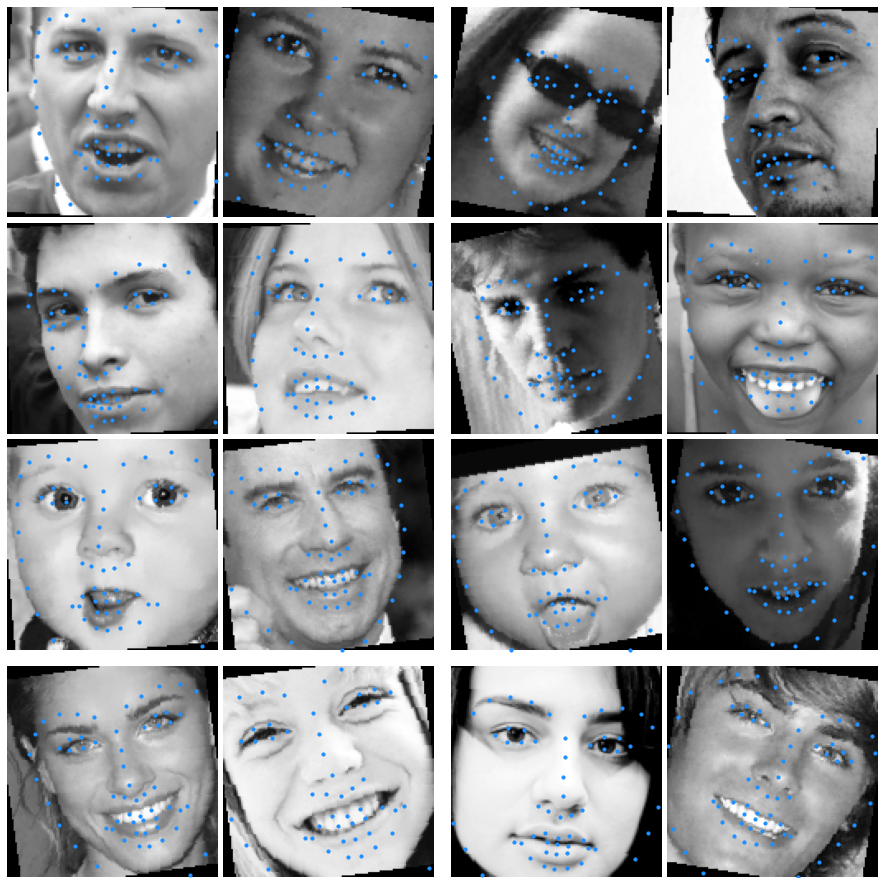

Saving model....................
Epoch(5/30) -> Training Loss: 0.00202155 | Validation Loss: 0.00172486



Validation Sample Predictions


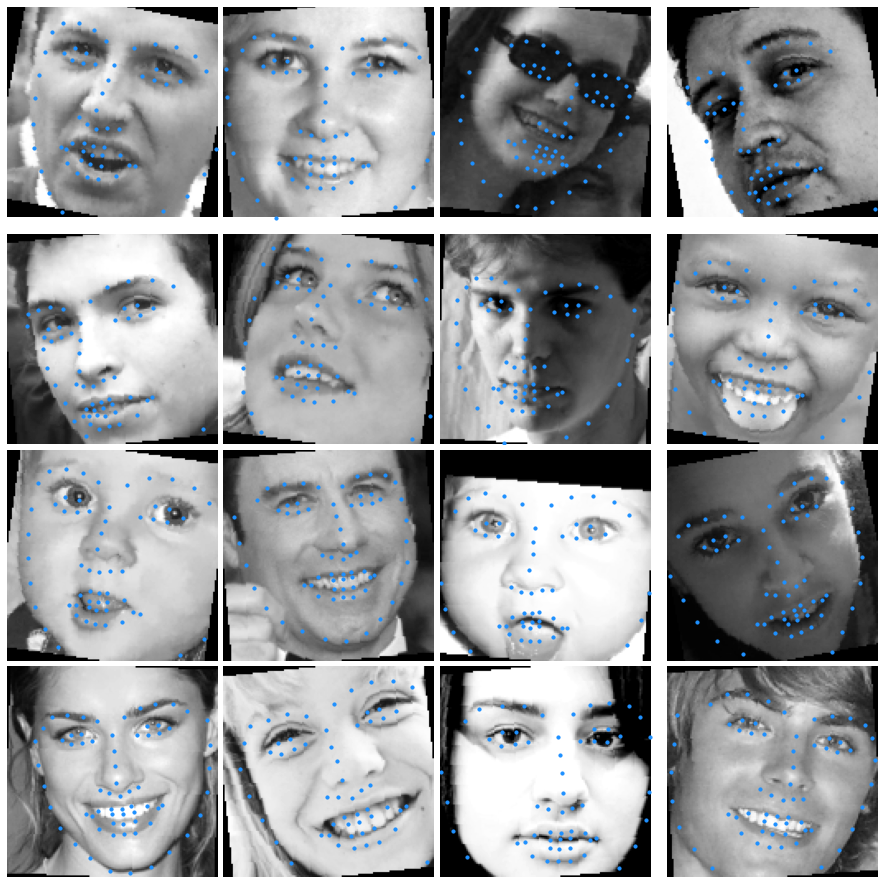

Saving model....................
Epoch(6/30) -> Training Loss: 0.00172481 | Validation Loss: 0.00143114



Validation Sample Predictions


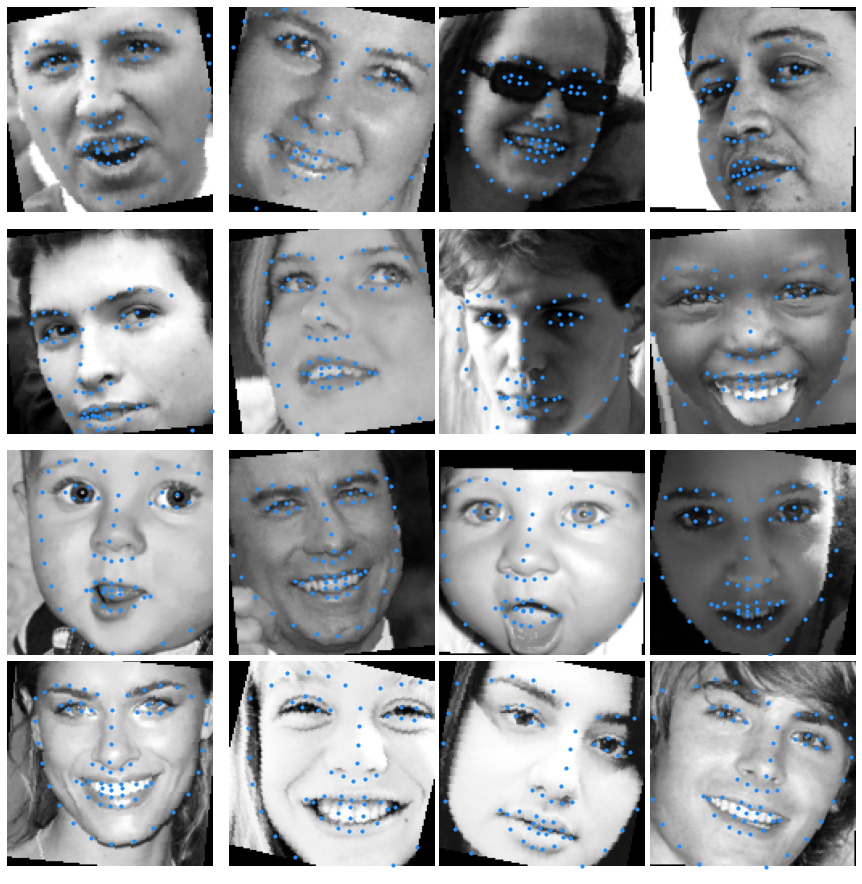

Saving model....................
Epoch(7/30) -> Training Loss: 0.00151476 | Validation Loss: 0.00135104



Validation Sample Predictions


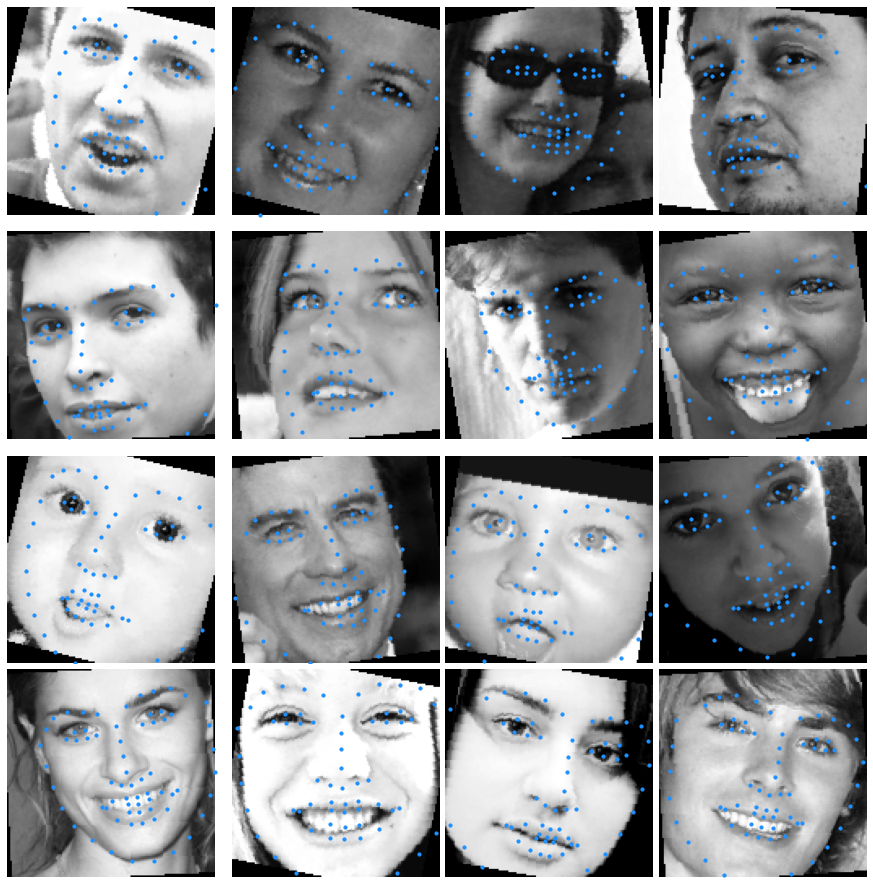

Saving model....................
Epoch(8/30) -> Training Loss: 0.00141047 | Validation Loss: 0.00127340



Validation Sample Predictions


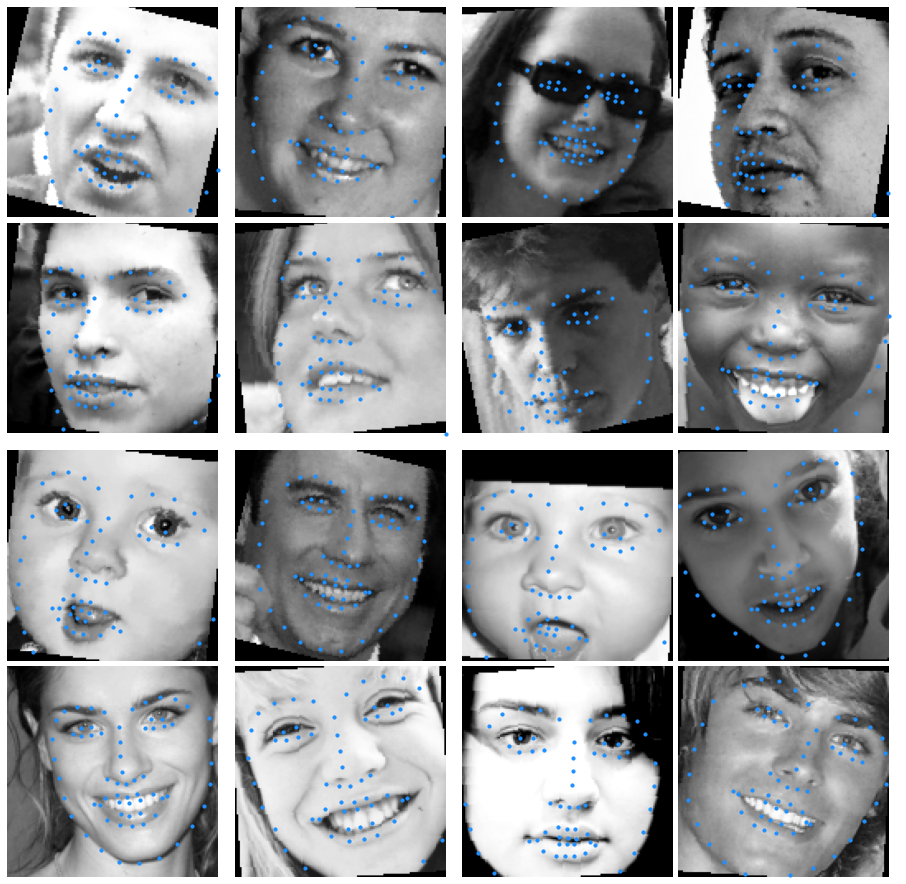

Epoch(9/30) -> Training Loss: 0.00132263 | Validation Loss: 0.00153900



Validation Sample Predictions


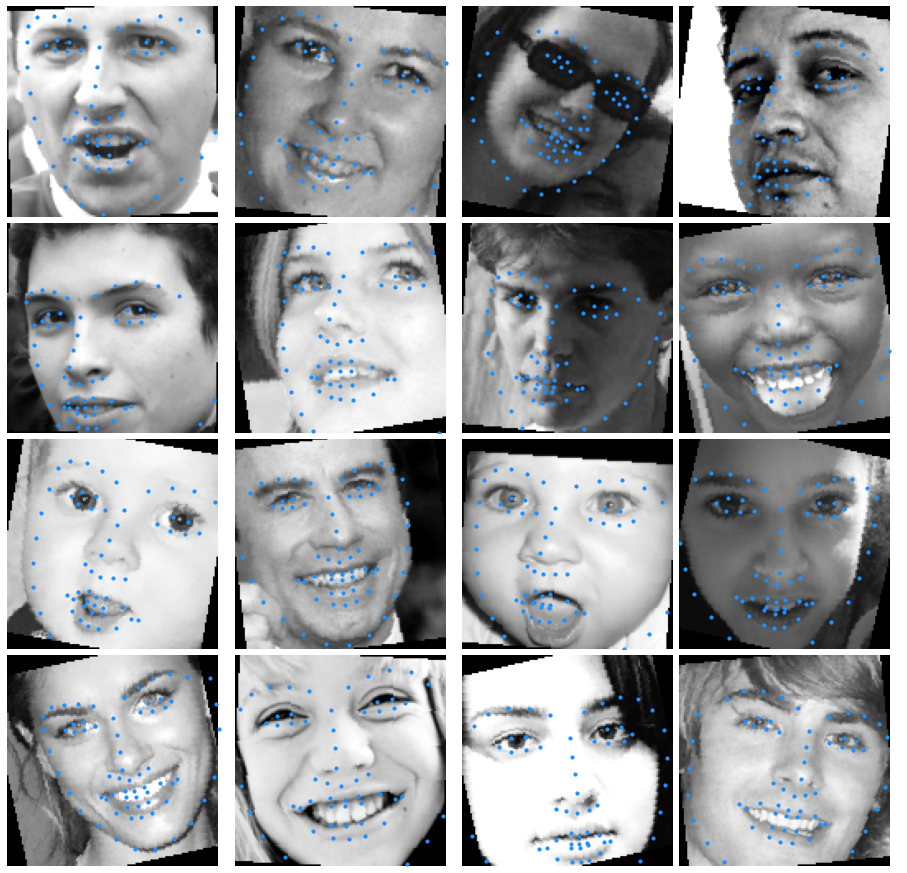

Saving model....................
Epoch(10/30) -> Training Loss: 0.00122250 | Validation Loss: 0.00114732



Validation Sample Predictions


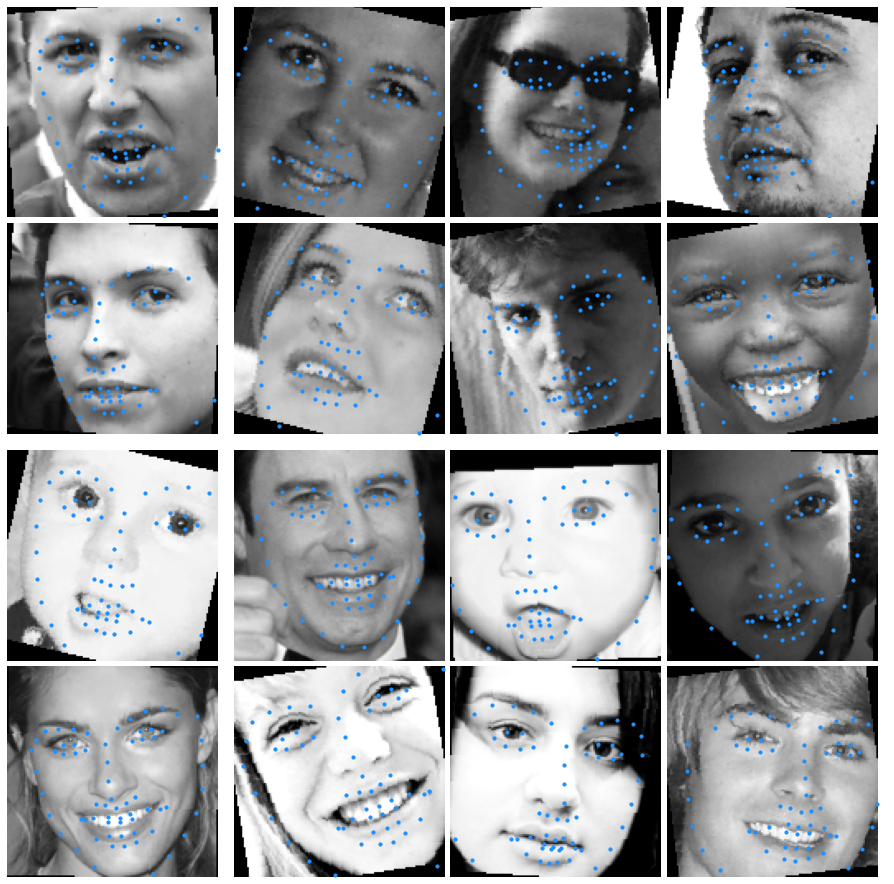

Epoch(11/30) -> Training Loss: 0.00112294 | Validation Loss: 0.00178978



Validation Sample Predictions


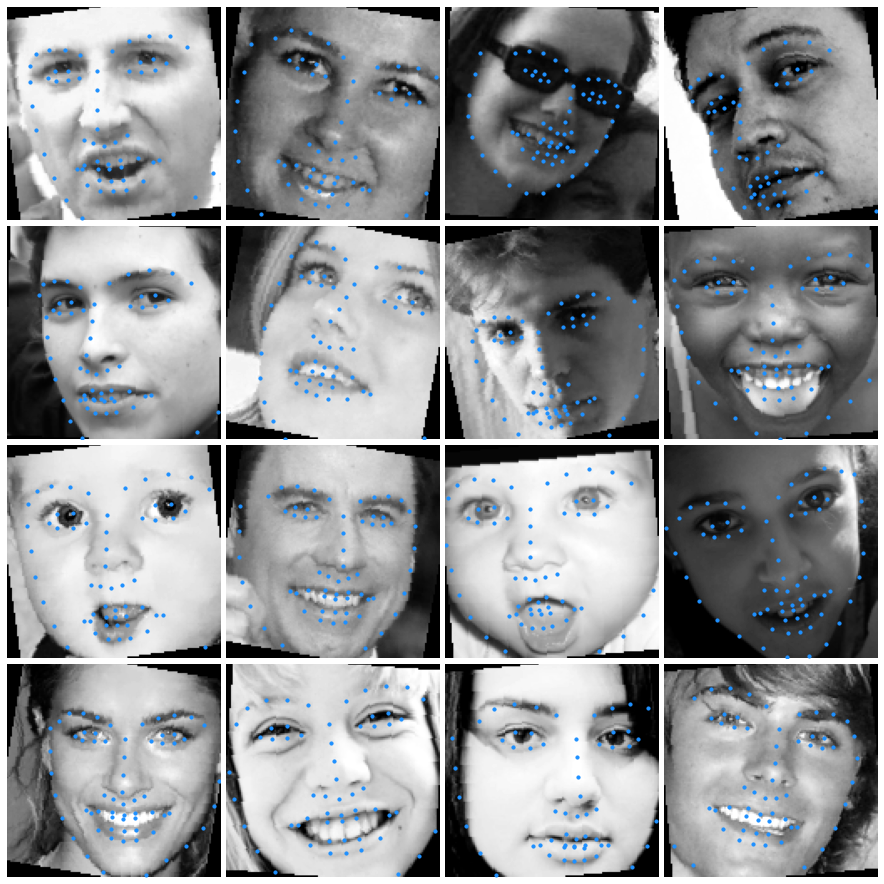

Saving model....................
Epoch(12/30) -> Training Loss: 0.00111583 | Validation Loss: 0.00086099



Validation Sample Predictions


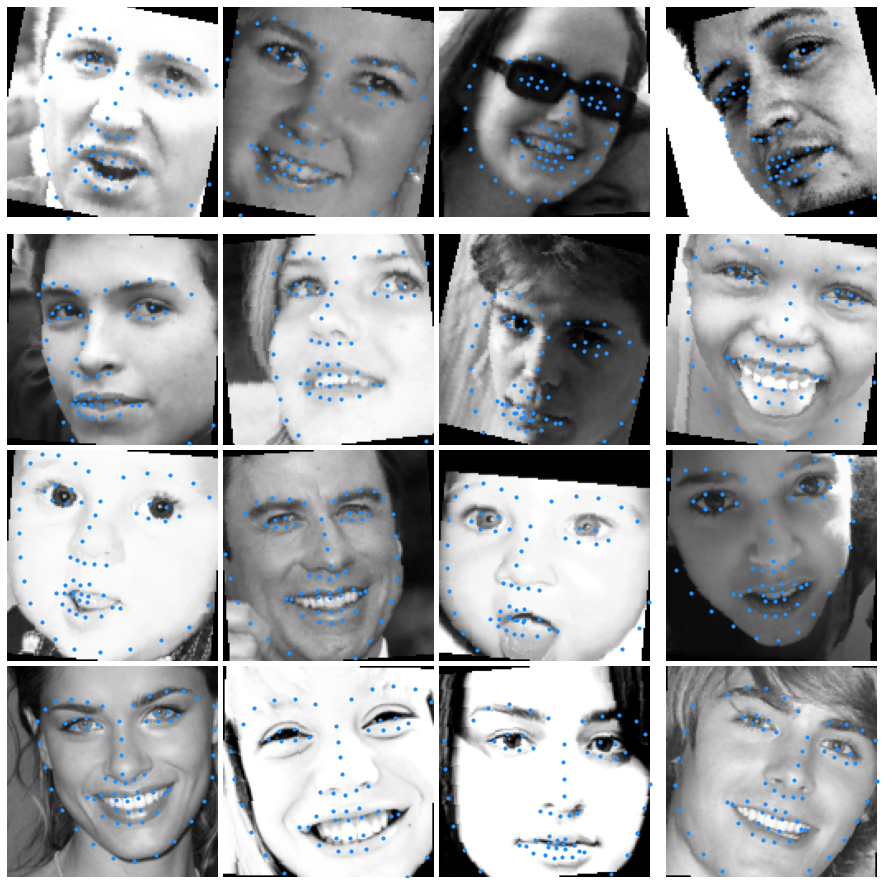

Epoch(13/30) -> Training Loss: 0.00105304 | Validation Loss: 0.00135694



Validation Sample Predictions


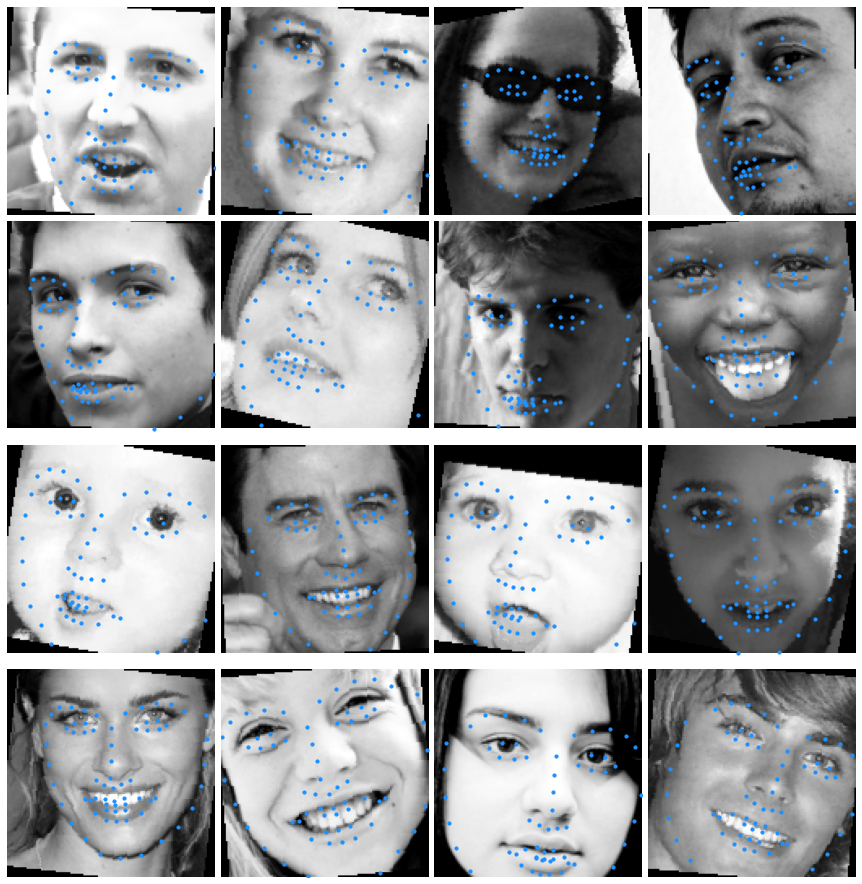

Epoch(14/30) -> Training Loss: 0.00101952 | Validation Loss: 0.00138617



Validation Sample Predictions


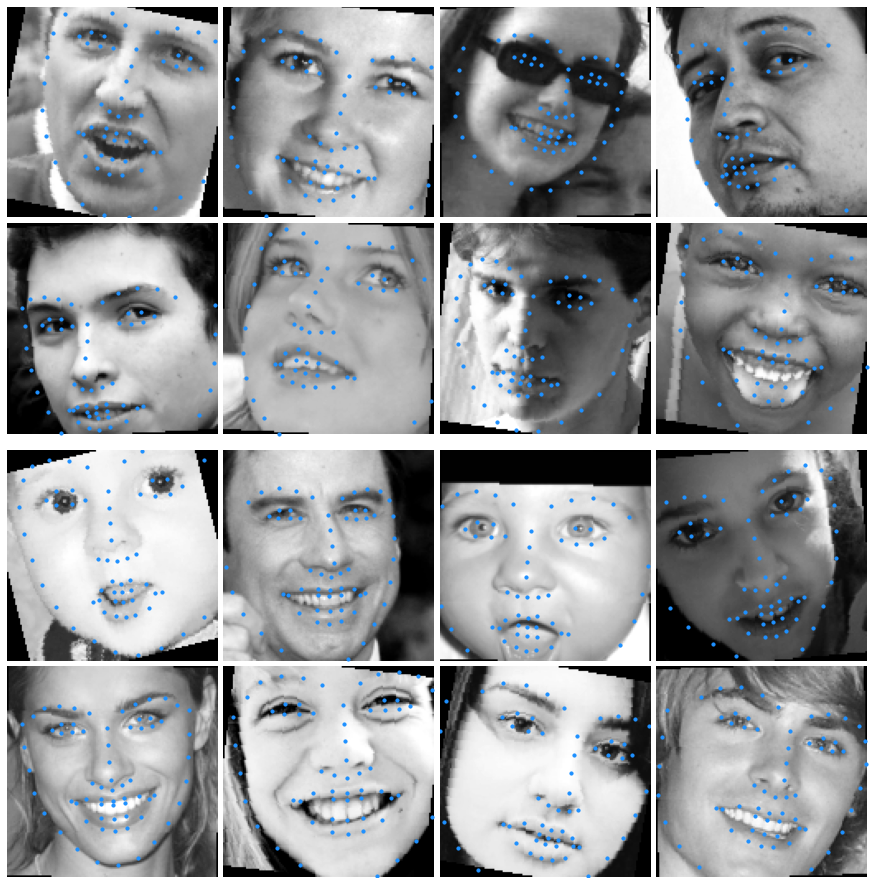

Epoch(15/30) -> Training Loss: 0.00095713 | Validation Loss: 0.00087264



Validation Sample Predictions


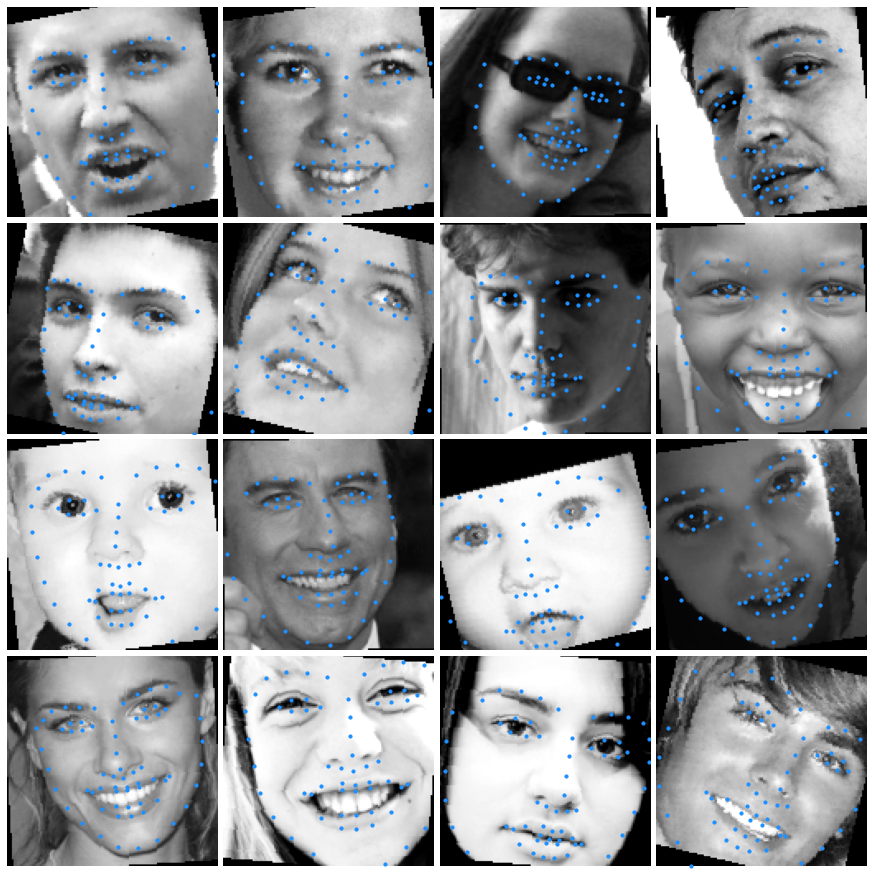

Epoch(16/30) -> Training Loss: 0.00091005 | Validation Loss: 0.00094471



Validation Sample Predictions


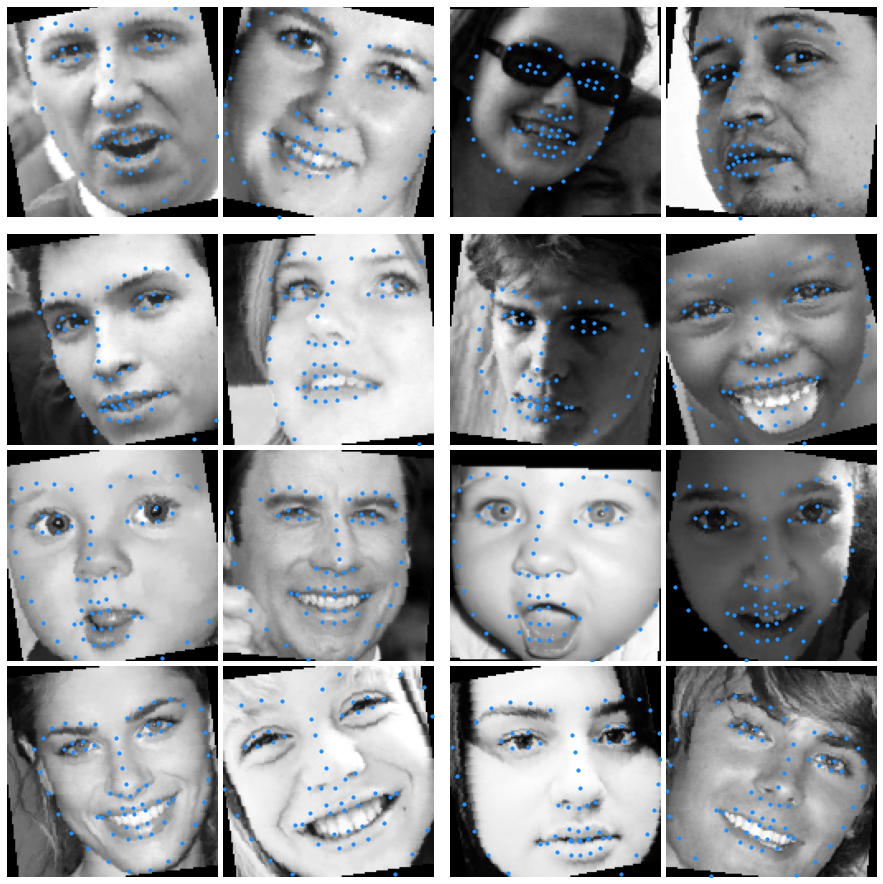

Epoch(17/30) -> Training Loss: 0.00085721 | Validation Loss: 0.00090248



Validation Sample Predictions


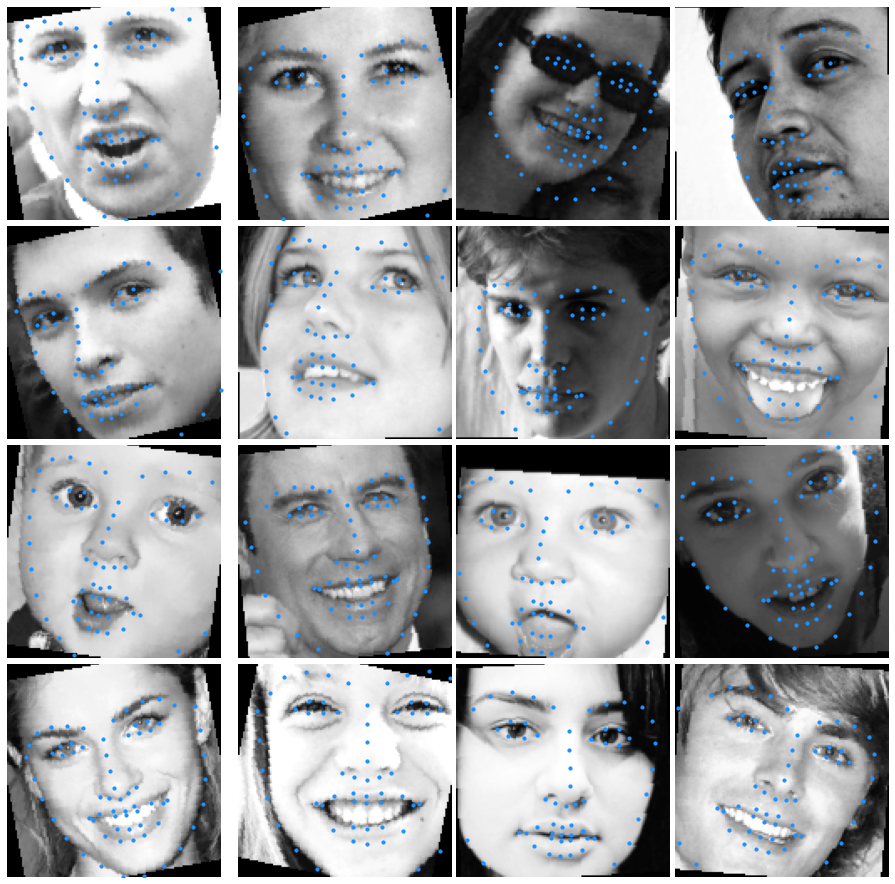

Saving model....................
Epoch(18/30) -> Training Loss: 0.00082464 | Validation Loss: 0.00067815



Validation Sample Predictions


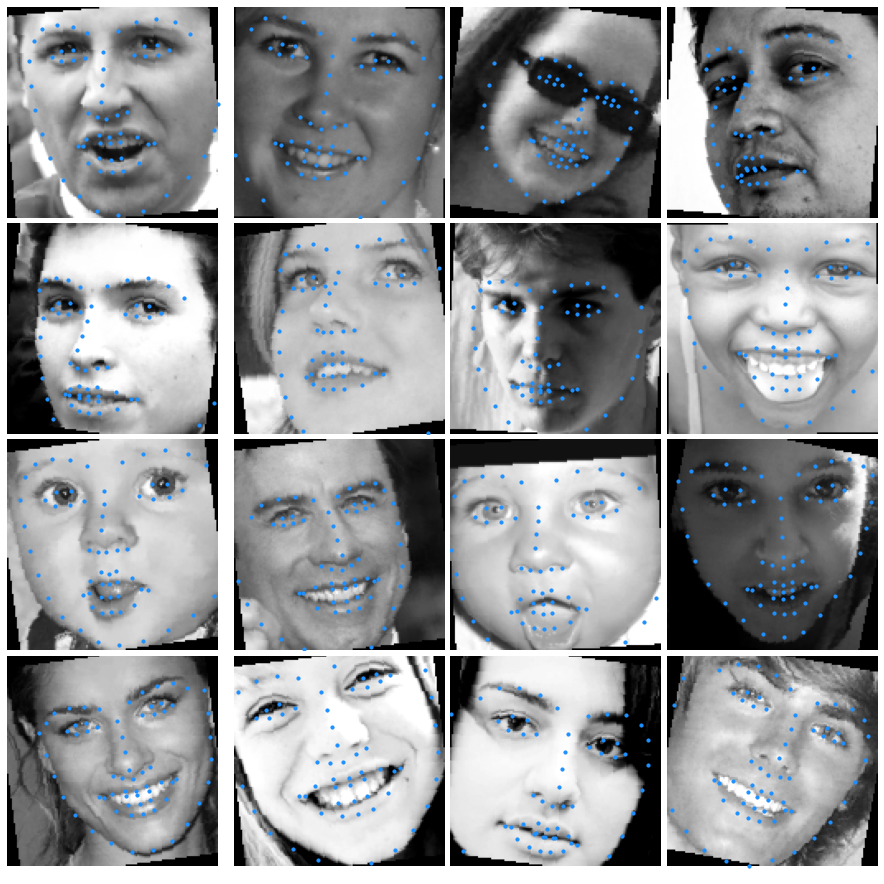

Saving model....................
Epoch(19/30) -> Training Loss: 0.00080445 | Validation Loss: 0.00065795



Validation Sample Predictions


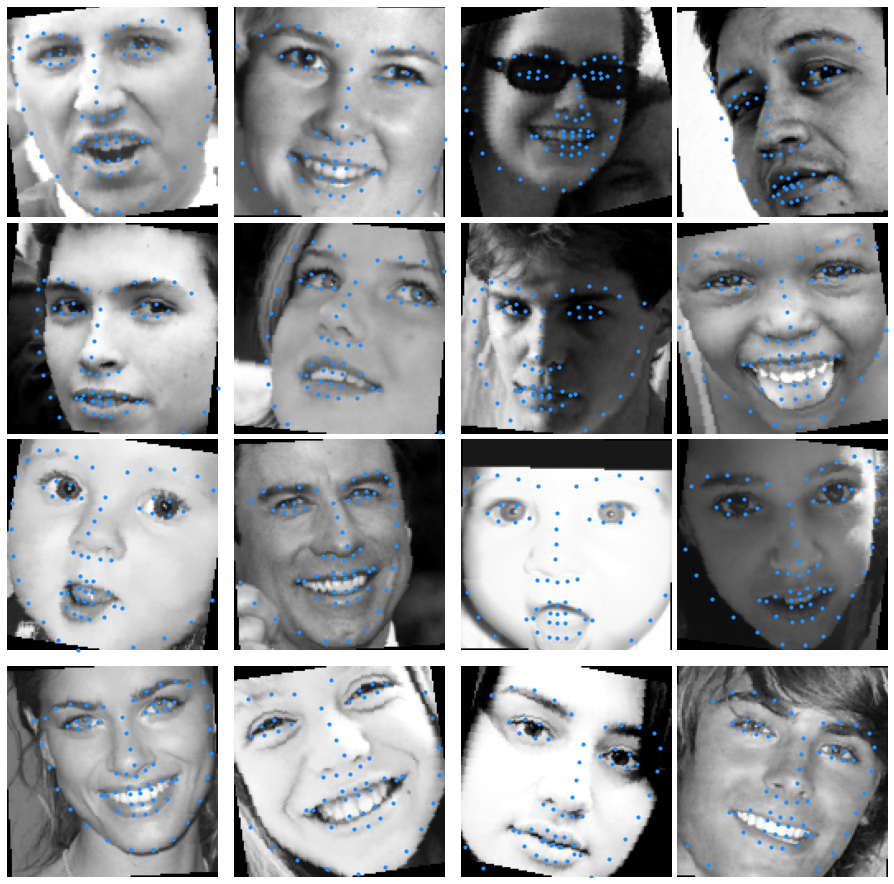

Epoch(20/30) -> Training Loss: 0.00079032 | Validation Loss: 0.00096902



Validation Sample Predictions


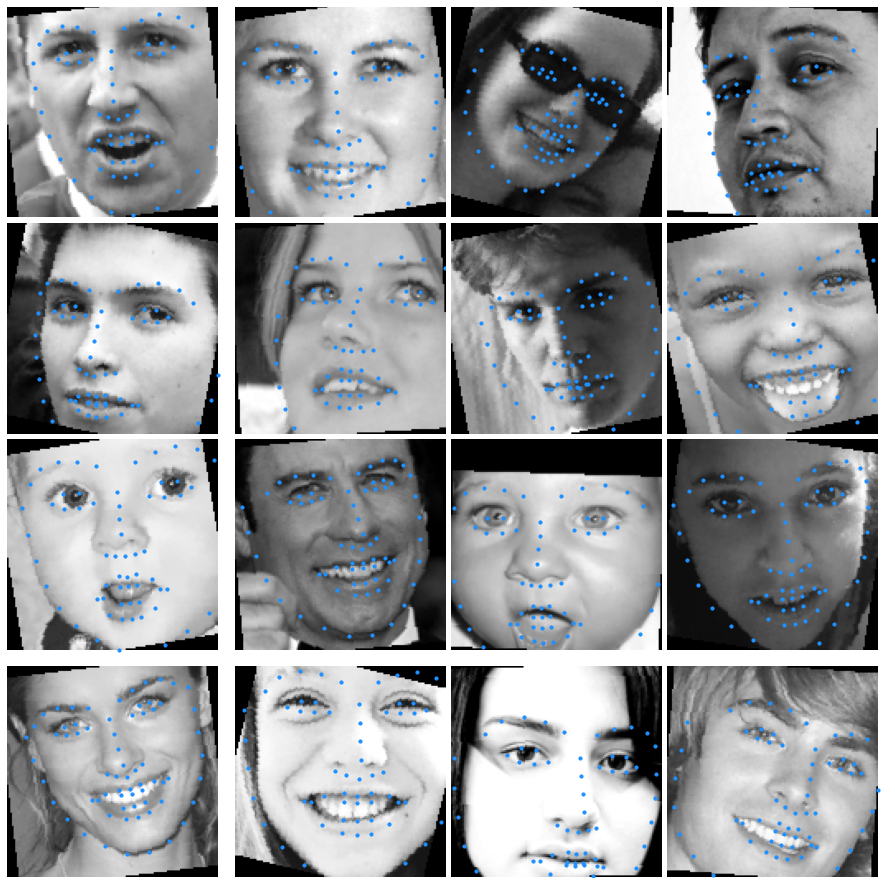

Epoch(21/30) -> Training Loss: 0.00076696 | Validation Loss: 0.00080290



Validation Sample Predictions


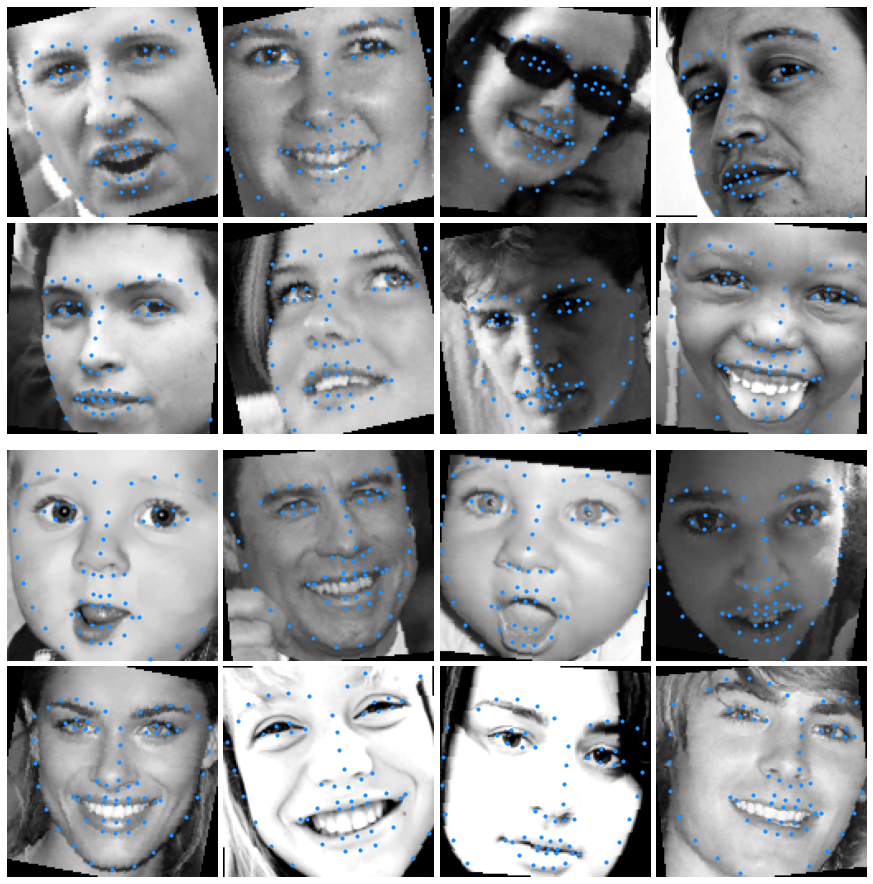

Epoch(22/30) -> Training Loss: 0.00078113 | Validation Loss: 0.00082533



Validation Sample Predictions


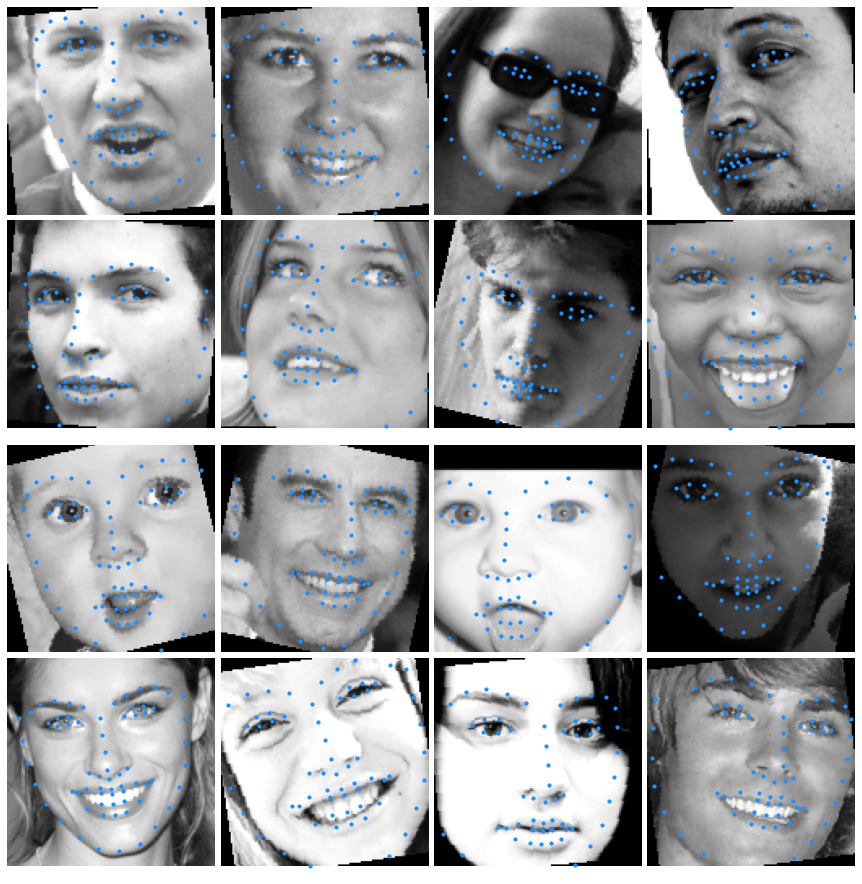

Epoch(23/30) -> Training Loss: 0.00071256 | Validation Loss: 0.00091474



Validation Sample Predictions


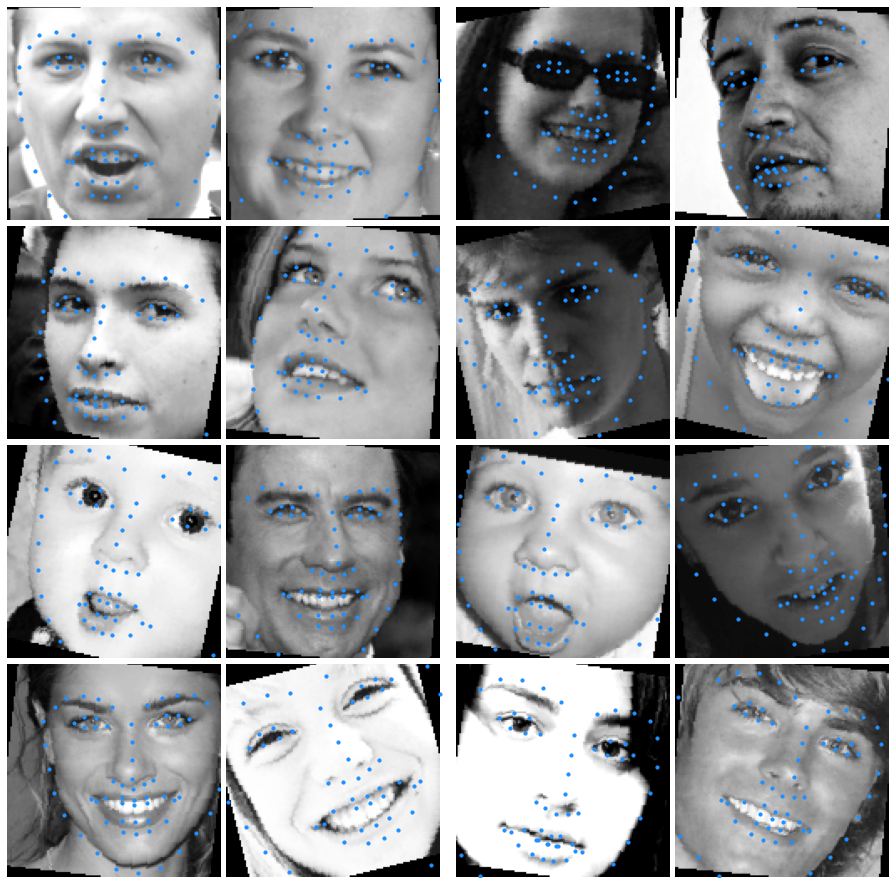

Epoch(24/30) -> Training Loss: 0.00068772 | Validation Loss: 0.00075456



Validation Sample Predictions


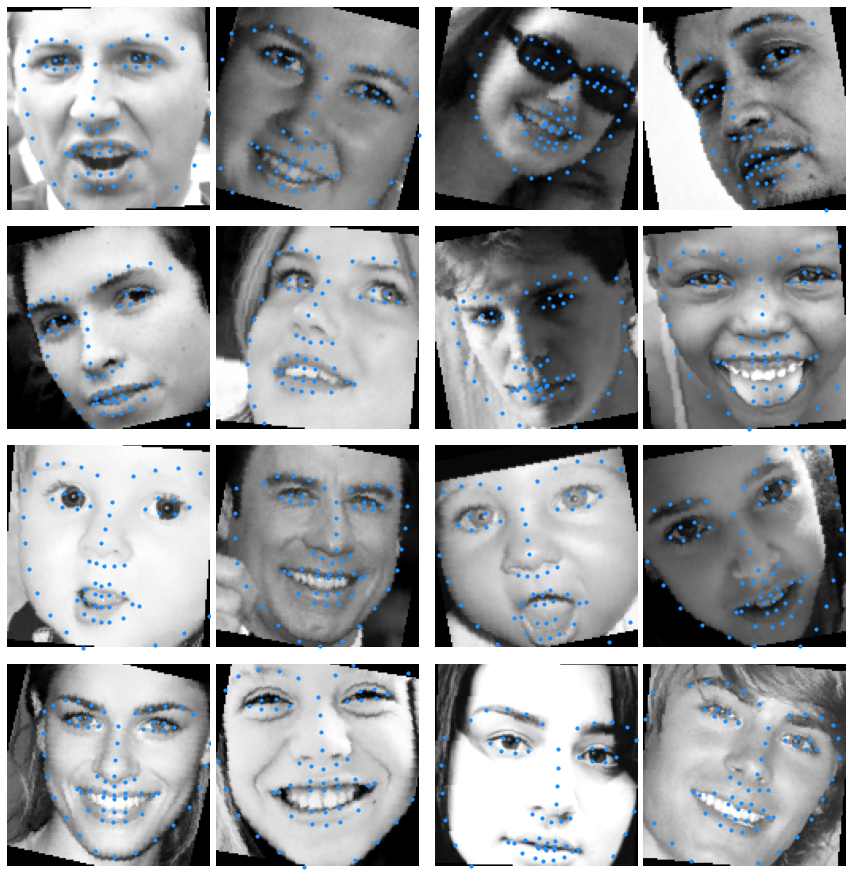

Epoch(25/30) -> Training Loss: 0.00065070 | Validation Loss: 0.00073119



Validation Sample Predictions


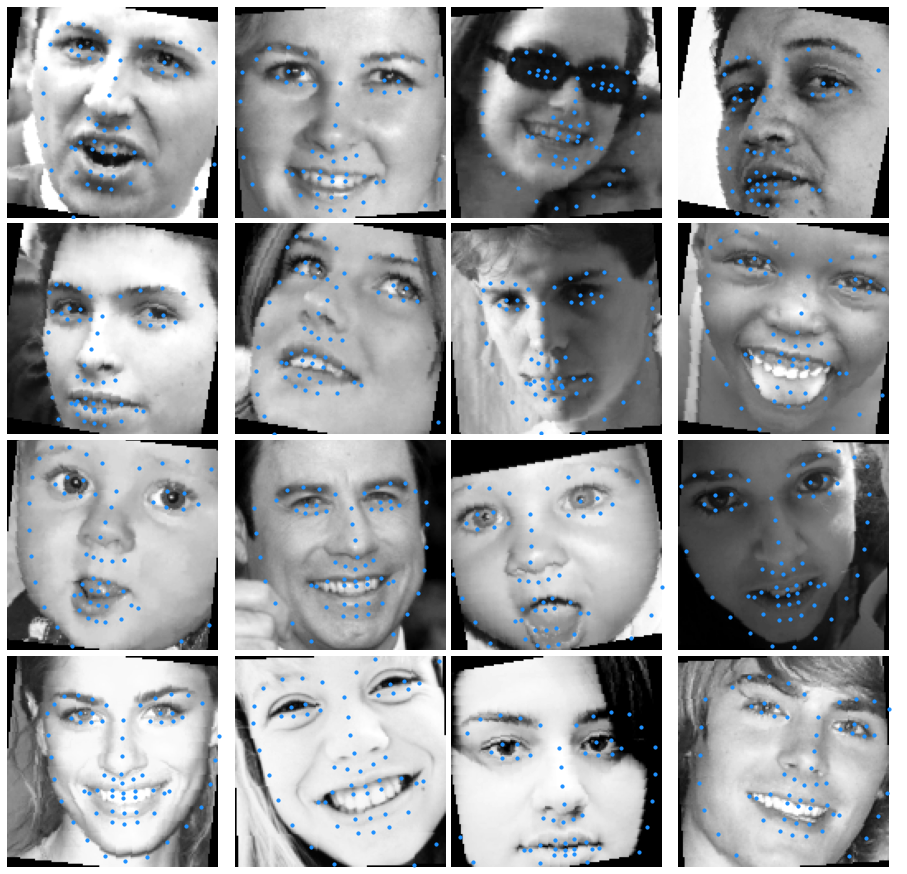

Epoch(26/30) -> Training Loss: 0.00064823 | Validation Loss: 0.00088016



Validation Sample Predictions


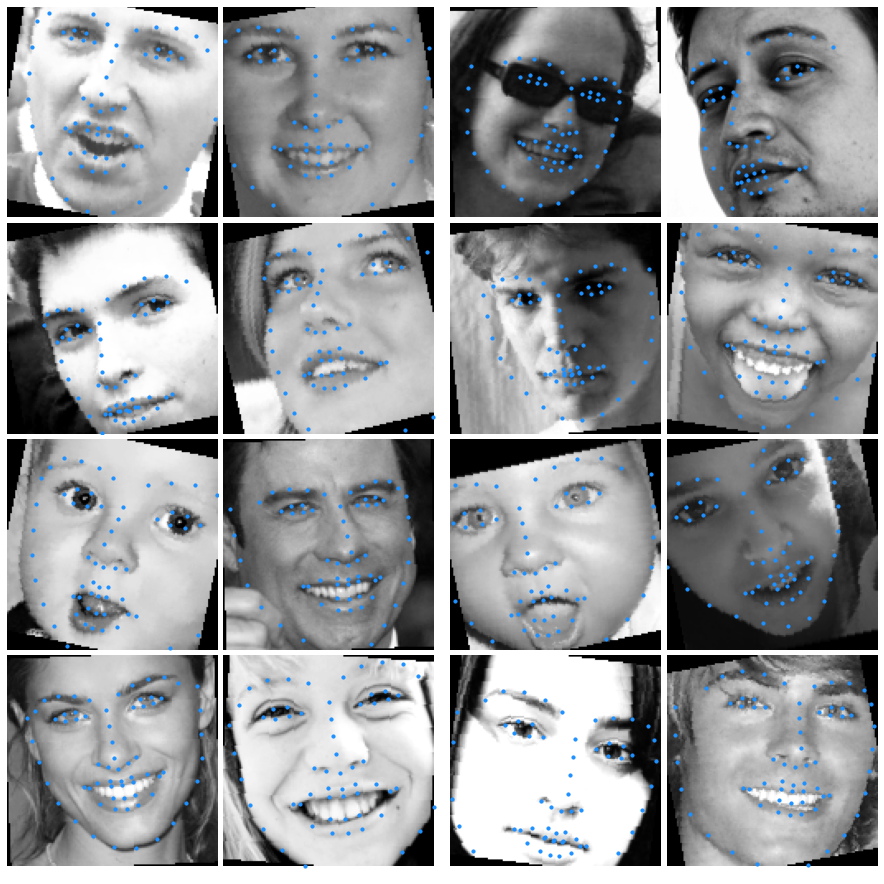

Epoch(27/30) -> Training Loss: 0.00063785 | Validation Loss: 0.00068399



Validation Sample Predictions


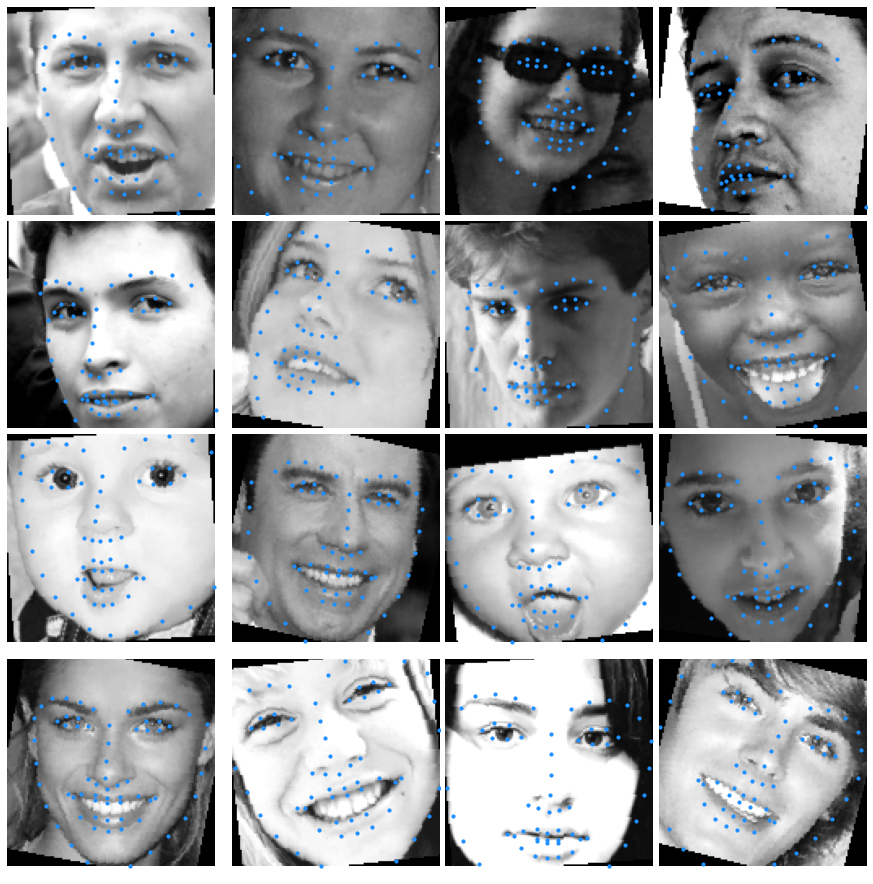

Epoch(28/30) -> Training Loss: 0.00061232 | Validation Loss: 0.00066729



Validation Sample Predictions


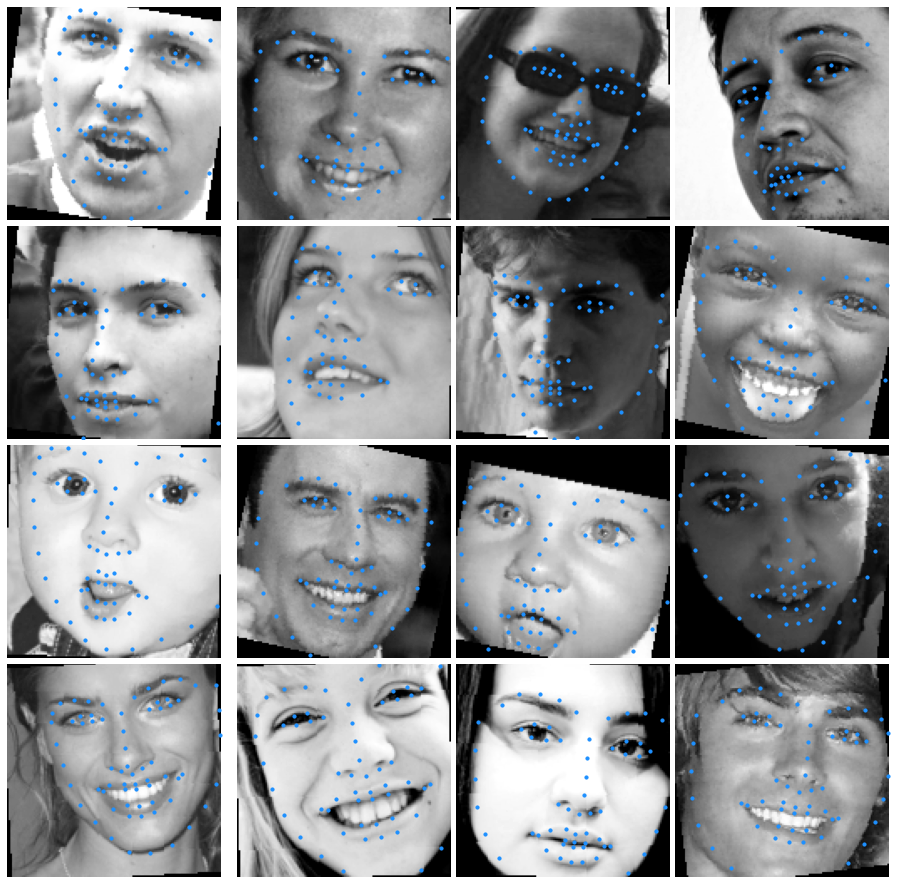

Epoch(29/30) -> Training Loss: 0.00060144 | Validation Loss: 0.00072809



Validation Sample Predictions


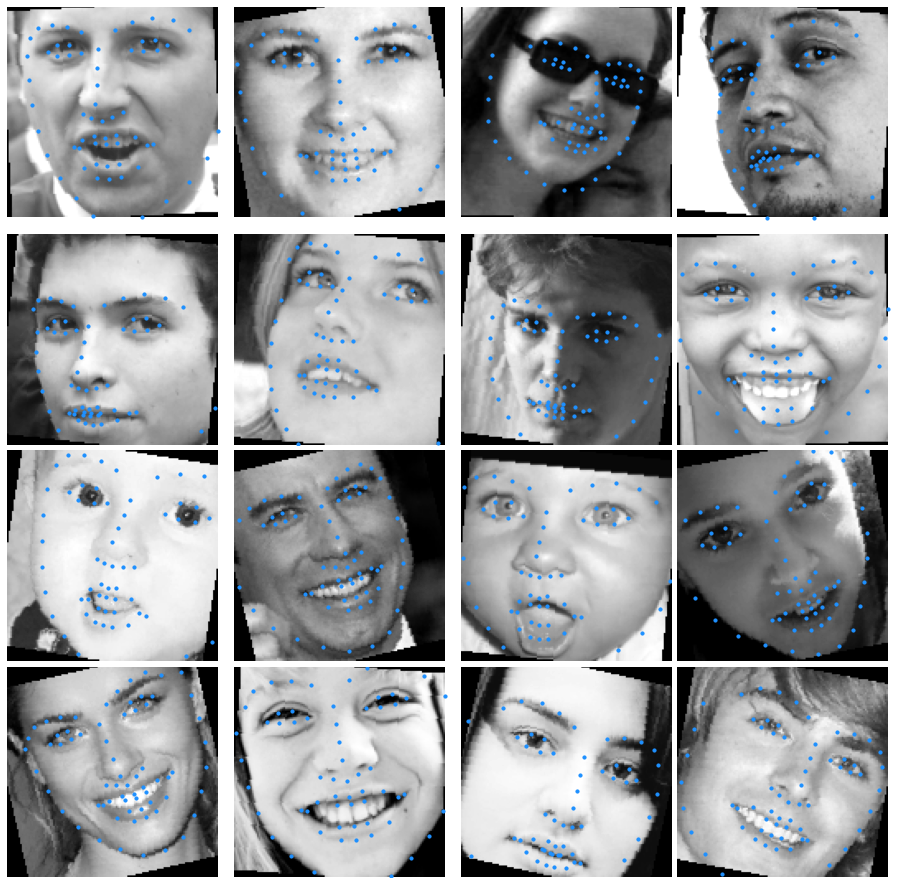

Saving model....................
Epoch(30/30) -> Training Loss: 0.00058971 | Validation Loss: 0.00062889


In [ ]:
epochs = 30
batches = len(train_data)
best_loss = np.inf
optimizer.zero_grad()

for epoch in range(epochs):
    cum_loss = 0.0

    model.train()
    for batch_index, (features, labels) in enumerate(tqdm(train_data, desc = f'Epoch({epoch + 1}/{epochs})', ncols = 800)):
        features = features.cuda()
        labels = labels.cuda()

        outputs = model(features)
        
        loss = objective(outputs, labels)

        loss.backward()

        optimizer.step()
        
        optimizer.zero_grad()

        cum_loss += loss.item()

    val_loss = validate(os.path.join('progress', f'epoch({str(epoch + 1).zfill(len(str(epochs)))}).jpg'))

    if val_loss < best_loss:
        best_loss = val_loss
        print('Saving model....................')
        torch.save(model.state_dict(), 'model.pt')

    print(f'Epoch({epoch + 1}/{epochs}) -> Training Loss: {cum_loss/batches:.8f} | Validation Loss: {val_loss:.8f}')

# __Inference__

In [26]:
model.load_state_dict(torch.load('model.pt', map_location = 'cpu'))

<All keys matched successfully>

In [24]:
!pip install youtube-dl
!pip install moviepy

     |████████████████████████████████| 1.8MB 3.5MB/s 


In [25]:
import dlib
import youtube_dl
from imutils import face_utils, resize
from moviepy.editor import VideoFileClip

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)1515520/45929032 bytes (3.3%)4284416/45929032 bytes (9.3%)7610368/45929032 bytes (16.6%)10944512/45929032 bytes (23.8%)14450688/45929032 bytes (31.5%)17883136/45929032 bytes (38.9%)21102592/45929032 bytes (45.9%)24485888/45929032 bytes (53.3%)27942912/45929032 bytes (60.8%)31383552/45929032 bytes (68.3%)33816576/45929032 bytes (73.6%)36290560/45929032 bytes (79.0%)3

In [37]:
def preprocess_image(image):
    image = TF.to_pil_image(image)
    image = TF.resize(image, (128, 128))
    image = TF.to_tensor(image)
    image = (image - image.min())/(image.max() - image.min())
    image = (2 * image) - 1
    return image.unsqueeze(0)

def draw_landmarks_on_faces(image, faces_landmarks):
    image = image.copy()
    for landmarks, (left, top, height, width) in faces_landmarks:
        landmarks = landmarks.view(-1, 2)
        landmarks = (landmarks + 0.5)
        landmarks = landmarks.numpy()
        
        for i, (x, y) in enumerate(landmarks, 1):
            try:
                cv2.circle(image, (int((x * width) + left), int((y * height) + top)), 2, [40, 117, 255], -1)
            except:
                pass
    
    return image

In [27]:
face_detector = dlib.get_frontal_face_detector()

@torch.no_grad()
def inference(frame):
    gray = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)
    faces = face_detector(gray, 1)

    outputs = []

    for (i, face) in enumerate(faces):
        (x, y, w, h) = face_utils.rect_to_bb(face)

        crop_img = gray[y: y + h, x: x + w]
        preprocessed_image = preprocess_image(crop_img)
        landmarks_predictions = model(preprocessed_image.cuda())
        outputs.append((landmarks_predictions.cpu(), (x, y, h, w)))

    return draw_landmarks_on_faces(frame, outputs)

In [28]:
def output_video(video, name, seconds = None):
    total = int(video.fps * seconds) if seconds else int(video.fps * video.duration)
    print('Will read', total, 'images...')
    
    outputs = []

    writer = cv2.VideoWriter(name + '.mp4', cv2.VideoWriter_fourcc(*'mp4v'), video.fps, tuple(video.size))

    for i, frame in enumerate(tqdm(video.iter_frames(), total = total), 1):    
        if seconds:
            if (i + 1) == total:
                break
                
        output = inference(frame)
        outputs.append(output)

        writer.write(cv2.cvtColor(output, cv2.COLOR_RGB2BGR))

    writer.release()

    return outputs

In [29]:
ydl_opts = {}
with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    ydl.download(['https://www.youtube.com/watch?v=kib6uXQsxBA'])

[youtube] kib6uXQsxBA: Downloading webpage
[download] Destination: Steve Jobs on Quality-kib6uXQsxBA.f134.mp4
[download] 100% of 3.03MiB in 00:00
[download] Destination: Steve Jobs on Quality-kib6uXQsxBA.f140.m4a
[download] 100% of 2.92MiB in 00:00
[ffmpeg] Merging formats into "Steve Jobs on Quality-kib6uXQsxBA.mp4"
Deleting original file Steve Jobs on Quality-kib6uXQsxBA.f134.mp4 (pass -k to keep)
Deleting original file Steve Jobs on Quality-kib6uXQsxBA.f140.m4a (pass -k to keep)


In [31]:
video = VideoFileClip("jobs.mp4")
print('FPS:', video.fps)
print('Duration:', video.duration, 'seconds')

FPS: 10.0
Duration: 189.06 seconds


(360, 576, 3)


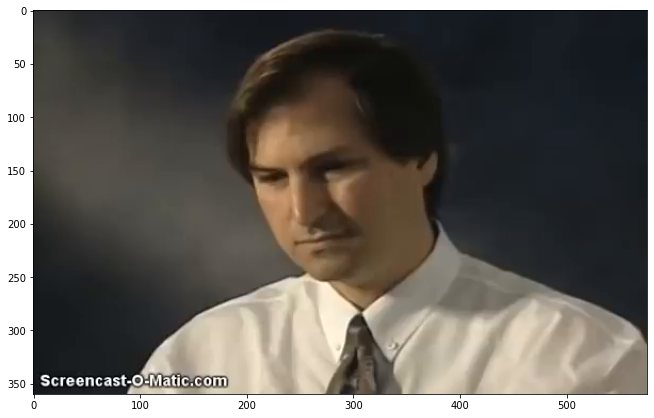

In [32]:
for frame in video.iter_frames():
    break

print(frame.shape)
plt.figure(figsize = (11, 11))
plt.imshow(frame)

In [38]:
outputs = output_video(video, 'jobs_output')

Will read 1890 images...


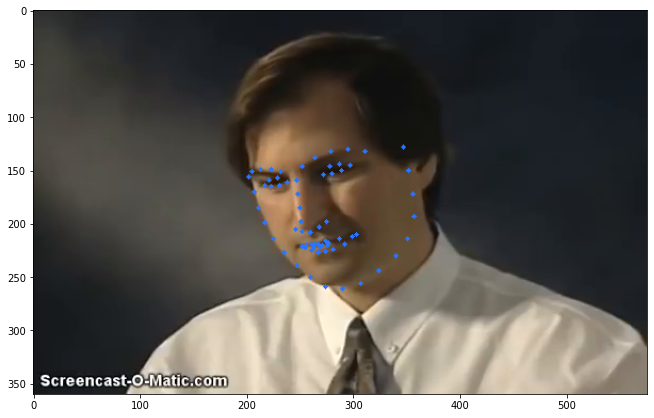

In [39]:
plt.figure(figsize = (11, 11))
plt.imshow(outputs[10]) # yayaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaa